# **University Life in Udine**

## *Universities and Points of Interest*

Are you a student wishing to study in Udine? Here's everything you need to know.

### **Some info about the notebook**

In this notebook there will be content designed specifically for users, others for programmers.

This distinction is made explicit by the use of the following icons:
- User 🧍‍♂️
- Programmer 👨‍💻

In the first part of the notebook we show the `plot_udine_map()` function and explain how it works. 

In the second part we present *real-life usage scenarios* in which the function can be used to provide information to the user. You can find a more visually appealing version of the scenarios on the following [website](https://danielepassabi.github.io/uni/geo/udine_uni_life.html).

---

## **Setup** 👨‍💻 

We import the necessary libraries for the notebook to correctly work.

In [1]:
# Import Libraries
import geopandas as gpd
import pygeos
import pyrosm
import matplotlib.pyplot as plt
import geopy
import pandana
import osmnx as ox
from pprint import pprint
import pandas as pd
import os
import sys

# Import custom modules
sys.path.insert(0, os.path.abspath('../')) # need to pass absolute path in nb

from functions.dataviz_geopandas import plot_udine_map, extract_info_from_dict

print("> Setup Completed")

> Setup Completed


## **Map of the City**

### **Import necessary data** 👨‍💻

In order, we use:
- data from the Italian municipalities, which were provided to us during the course
- the .pbf of the city of Udine, obtained using [Wikimedia Italy](https://osmit-estratti.wmcloud.org/)

In [2]:
# import data on Italian municipalities
italy_municipalities_path = "../data/Com01012021_g/Com01012021_g_WGS84.shp"
italy_municipalities = gpd.read_file(italy_municipalities_path)

# save Udine and the municipalities in the province of Udine
udine_geodf = italy_municipalities.loc[italy_municipalities["COMUNE"] == "Udine"]
udine_mun_geodf = italy_municipalities.loc[italy_municipalities["COD_PROV"] == 30]

In [3]:
# we now import the .pbf file of the city, obtained through Wikimedia Italy
udine_osm = pyrosm.OSM("../data/udine.osm.pbf")

### **Plot the base map of Udine** 👨‍💻 

We start by showing the simplest map that can be obtained, showing only the streets and buildings on the map of Udine.

The thicker and darker streets are for cars, while the thinner and lighter ones are for pedestrians.

<center>
    <img src="../images/streets_legend.jpg">
</center>

> Obtaining Buildings from OSM
> Obtaining Streets from OSM
> Clipping Buildings and Streets
> Generating Base Map
> Adding Buildings
> Adding Streets
> Saving the image

> Elapsed Time: 13.17 seconds


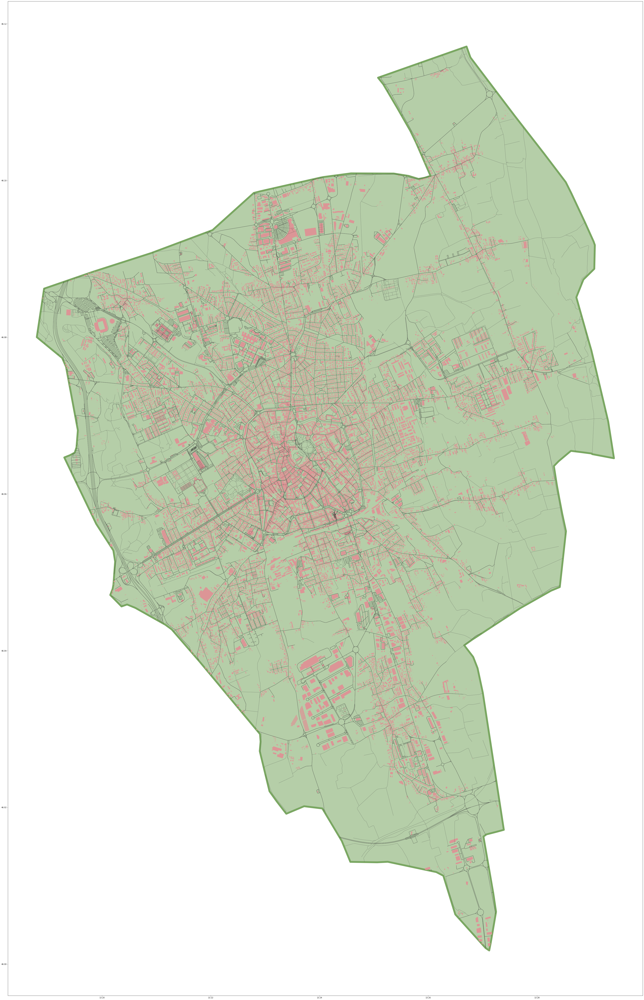

In [4]:
base_map = plot_udine_map(
    udine_geodf = udine_geodf, 
    udine_osm = udine_osm, 
    list_of_places = [],
    save = True,
    save_path="../dataviz/udine_base_map.jpg"
    )

*Note: you can find all the visualizations in the `dataviz` folder.*

### **Plot places of interest** 👨‍💻 

Using the `plot_udine_map()` function, we can plot many interesting places for students on the map of Udine.

The legend, with all possible types of obtainable places, follows. 

<img src="../images/udine_plot_complete_legend_inline.png">

In the following example we select all the possible places, plot them on the map and get their information.

> Obtaining Buildings from OSM
> Obtaining Streets from OSM
> Clipping Buildings and Streets
> Generating Base Map
> Adding Buildings
> Adding Streets
> Adding Universities
> Adding Supermarket
> Adding Hospitals
> Adding Eating Places
> Adding Bicycle Rental Locations
> Adding Car Rental Locations
> Adding Bus Stations
> Adding info about provided Address to the Map
 - Geocoding Address
 - Checking that the position found is within the boundaries of Udine
 - The location is within boundaries, adding Location to the Map
 - Obtaining Information about Required Locations
    * Supermarkets
    * Hospitals
    * Eating Places
    * Bicycle Rentals
    * Car Rentals
    * Bus Stations
> Saving the image

> Elapsed Time: 78.78 seconds


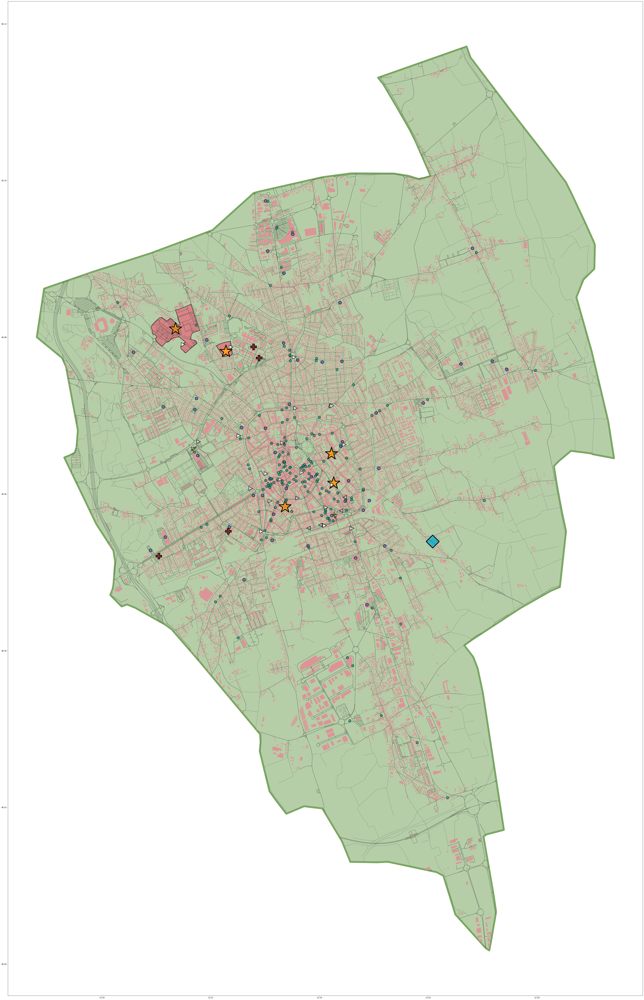

In [5]:
list_of_places_to_plot = [
    "university",
    "supermarket",
    "hospital",
    "eating place",
    "bicycle rental",
    "car rental",
    "bus station"
]

address = "Via Buttrio 286, Udine, Italy"

info_buttrio = plot_udine_map(
    udine_geodf = udine_geodf, 
    udine_osm = udine_osm, 
    list_of_places = list_of_places_to_plot,
    custom_address = address,
    save = True,
    save_path="../dataviz/udine_buttrio.jpg"
    )

When creating the map, we also obtain **additional information** on the required places.

- First we have the *distance to each university* location, considering the shortest route from the student's address.

- For each other type of places the function returns the *name* and *distance* of the nearest type of place, together with the *number of places within 1km* of the address given by the student.

The information is stored in a dictionary, let's explore it.

In [6]:
pprint(info_buttrio)

{'bicycle_rental': {'closest_distance': 1822.59,
                    'closest_name': 'Vascello',
                    'in_1km_area': 0},
 'bus_station': {'closest_distance': 2012.22,
                 'closest_name': 'Autostazione di Udine',
                 'in_1km_area': 0},
 'car_rental': {'closest_distance': 1638.86,
                'closest_name': 'Doraponti',
                'in_1km_area': 0},
 'eating_place': {'closest_distance': 1153.33,
                  'closest_name': 'Angolo della pizza',
                  'in_1km_area': 3},
 'hospital': {'closest_distance': 3668.86,
              'closest_name': 'Policlinico Città di Udine Polo 2',
              'in_1km_area': 0},
 'supermarket': {'closest_distance': 1234.42,
                 'closest_name': 'Coop',
                 'in_1km_area': 1},
 'university': {'Dipartimento di Scienze Giuridiche': 2044.03,
                'Università degli Studi di Udine - Dipartimento di Area medica': 4531.87,
                'Università degli Studi 

Although the dictionary is understandable, it is preferable to show the user the information in *tabular form*. 

We can do it using the `extract_info_from_dict()` function.

In [7]:
info = extract_info_from_dict(info_buttrio)

display(info[0])
display(info[1])

,University,Distance (m)
0,Dipartimento di Scienze Giuridiche,2044.03
1,Facoltà di Medicina e Chirurgia - Corsi di Lau...,1890.05
2,Facoltà di Scienze della Formazione,2758.94
3,Dipartimento di Area medica,4531.87
4,Polo Scientifico dei Rizzi,5293.57


,Location,Closest (name),Closest (distance),Total in 1km Area
0,supermarket,Coop,1234.42,1
1,hospital,Policlinico Città di Udine Polo 2,3668.86,0
2,eating_place,Angolo della pizza,1153.33,3
3,bicycle_rental,Vascello,1822.59,0
4,car_rental,Doraponti,1638.86,0
5,bus_station,Autostazione di Udine,2012.22,0


### **Plot the fastest routes to the Universities** 👨‍💻

In addition to obtaining information about universities and places, it is possible to display this information on the map using the following function parameters:
- `show_km_range`: shows the 1km area around the address provided by the student
- `plot_uni_routes`: shows the fastest routes to the required universities

The user can choose between 5 university locations (`list_of_uni` parameter):

- Dipartimento di Scienze Giuridiche
- Università degli Studi di Udine - Facoltà di Medicina e Chirurgia - Corsi di Laurea Area Sanitaria
- Università degli Studi di Udine - Facoltà di Scienze della Formazione
- Università degli Studi di Udine - Dipartimento di Area medica
- Università degli Studi di Udine - Polo Scientifico dei Rizzi

*Note: If you do not specify any university location, the function will report information on all of them.*

We will see how it works in *use cases*.

### **Use Cases** 🧍‍♂️

#### **Massimo**

<img src="../images/massimo.png" width="100">

Massimo took the test to get into medicine, but has not yet received the result. Besides medicine, he has a passion for law, which would be his second option.

He has decided to move to Udine as soon as possible. He is looking for a house that is close to both universities.

He does not like to cook, so he often eats out.

Massimo suffers from anaemia and often has to go to hospital for blood tests, so he would like his house to be close to a hospital.

He has found two flats in the following streets:
 - Via Guarnerio D'Artegna, 82
 - Via Cormor Alto, 29

Let's see how our map can help him.

> Obtaining Buildings from OSM
> Obtaining Streets from OSM
> Clipping Buildings and Streets
> Generating Base Map
> Adding Buildings
> Adding Streets
> Adding Universities
> Adding Hospitals
> Adding Eating Places
> Adding Bicycle Rental Locations
> Adding Bus Stations
> Adding info about provided Address to the Map
 - Geocoding Address
 - Checking that the position found is within the boundaries of Udine
 - The location is within boundaries, adding Location to the Map
 - Obtaining Information about Required Locations
    * Hospitals
    * Eating Places
    * Bicycle Rentals
    * Bus Stations
> Saving the image

> Elapsed Time: 67.74 seconds


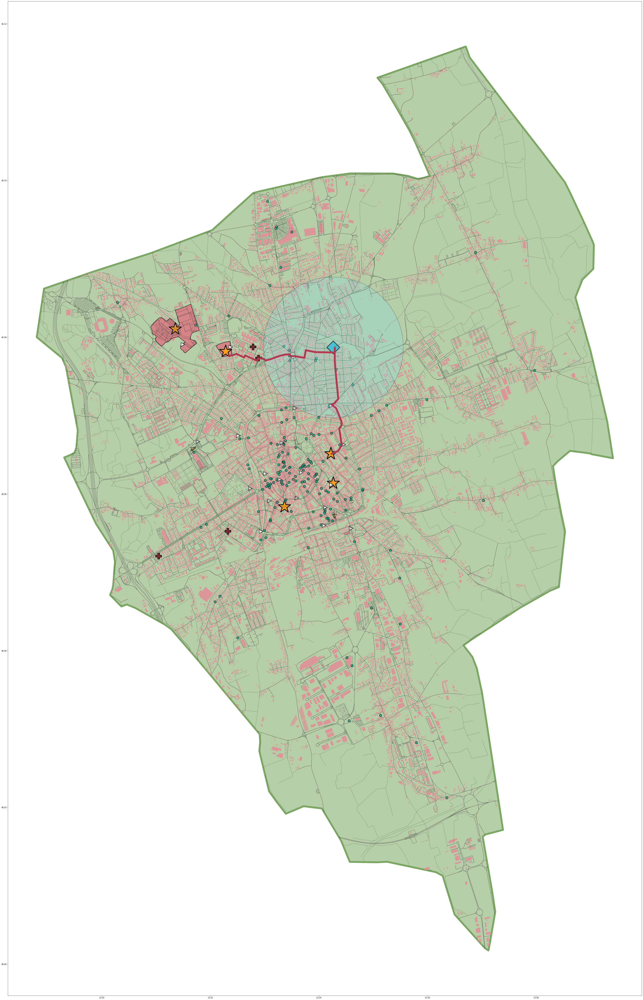

In [8]:
list_of_places_to_plot = [
    "university",
    #"supermarket",
    "hospital",
    "eating place",
    "bicycle rental",
    #"car rental",
    "bus station"
]

address = "Via Guarnerio D'Artegna 82, Udine, Italy"

list_of_uni = [
    "Università degli Studi di Udine - Dipartimento di Area medica",
    "Dipartimento di Scienze Giuridiche"
    ]

info_guarnerio_artedgna = plot_udine_map(
    udine_geodf = udine_geodf, 
    udine_osm = udine_osm, 
    list_of_places = list_of_places_to_plot,
    custom_address = address,
    show_km_range = True,
    plot_uni_routes = True,
    list_of_uni = list_of_uni,
    save = True,
    save_path="../dataviz/student_example_1A.jpg"
    )

In [9]:
info = extract_info_from_dict(info_guarnerio_artedgna)

display(info[0])
display(info[1])

,University,Distance (m)
0,Dipartimento di Scienze Giuridiche,1725.96
1,Dipartimento di Area medica,1803.20


,Location,Closest (name),Closest (distance),Total in 1km Area
0,hospital,Pronto Soccorso Udine,1307.34,0
1,eating_place,PIATTO C'ALDO,315.05,11
2,bicycle_rental,Chiavris,748.41,2
3,bus_station,Autostazione di Udine,2821.64,0


> Obtaining Buildings from OSM
> Obtaining Streets from OSM
> Clipping Buildings and Streets
> Generating Base Map
> Adding Buildings
> Adding Streets
> Adding Universities
> Adding Hospitals
> Adding Eating Places
> Adding Bicycle Rental Locations
> Adding Bus Stations
> Adding info about provided Address to the Map
 - Geocoding Address
 - Checking that the position found is within the boundaries of Udine
 - The location is within boundaries, adding Location to the Map
 - Obtaining Information about Required Locations
    * Hospitals
    * Eating Places
    * Bicycle Rentals
    * Bus Stations
> Saving the image

> Elapsed Time: 64.35 seconds


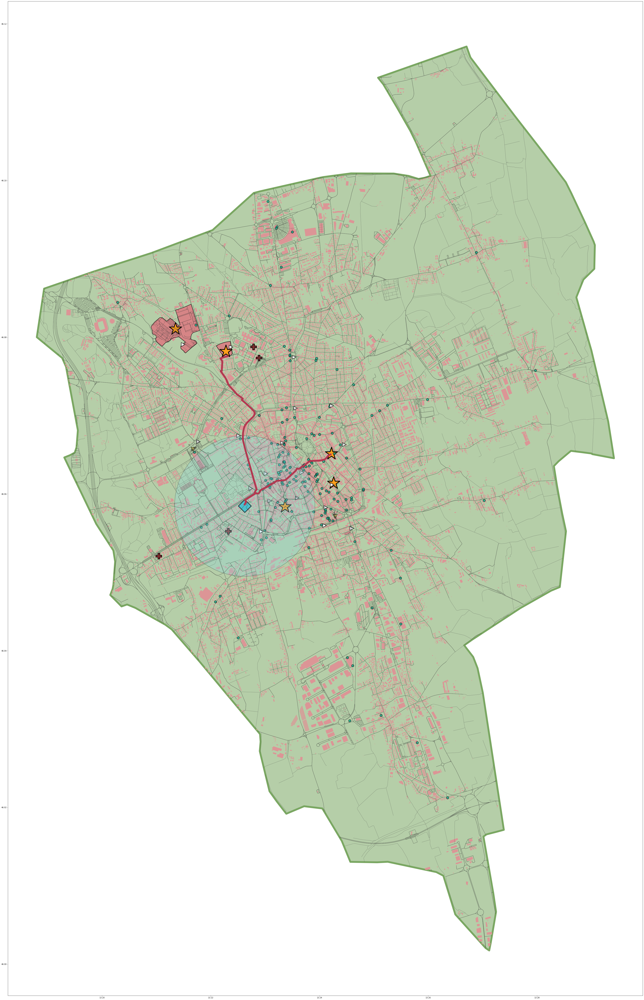

In [10]:
list_of_places_to_plot = [
    "university",
    #"supermarket",
    "hospital",
    "eating place",
    "bicycle rental",
    #"car rental",
    "bus station"
]

address = "Via S. Rocco 20, Udine, Italy"

list_of_uni = [
    "Università degli Studi di Udine - Dipartimento di Area medica",
    "Dipartimento di Scienze Giuridiche"
    ]

info_rocco = plot_udine_map(
    udine_geodf = udine_geodf, 
    udine_osm = udine_osm, 
    list_of_places = list_of_places_to_plot,
    custom_address = address,
    show_km_range = True,
    plot_uni_routes = True,
    list_of_uni = list_of_uni,
    save = True,
    save_path="../dataviz/student_example_1B.jpg"
    )

In [11]:
info = extract_info_from_dict(info_rocco)

display(info[0])
display(info[1])

,University,Distance (m)
0,Dipartimento di Scienze Giuridiche,1540.99
1,Dipartimento di Area medica,2605.93


,Location,Closest (name),Closest (distance),Total in 1km Area
0,hospital,Policlinico Città di Udine Polo 2,530.00,1
1,eating_place,Osteria Da Artico,393.95,68
2,bicycle_rental,Moretti,345.93,7
3,bus_station,Terminal Studenti,1337.19,0


Using the map he discovers that *Via S. Rocco* is closer to the hospital, and that he has numerous places to eat out around him.

The distance to the universities is similar, so Massimo has no more doubts and decides to move to the second flat.